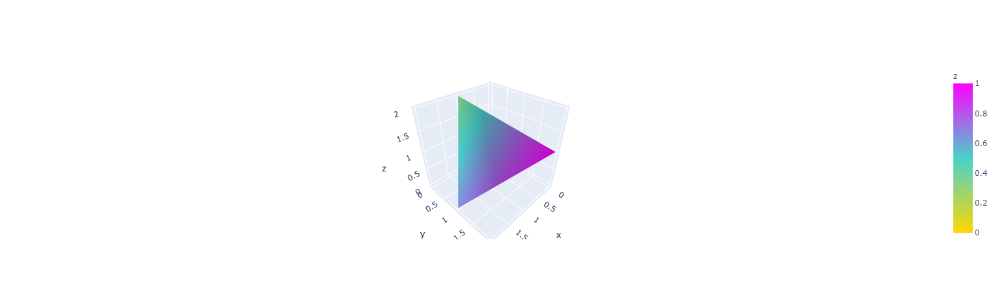

In [10]:
import plotly.graph_objects as go

fig = go.Figure(data=[
    go.Mesh3d(
        x=[0, 1, 2, 0],
        y=[0, 0, 1, 2],
        z=[0, 2, 0, 1],
        colorbar_title='z',
        colorscale=[[0, 'gold'],
                    [0.5, 'mediumturquoise'],
                    [1, 'magenta']],
        # Intensity of each vertex, which will be interpolated and color-coded
        intensity=[0, 0.33, 0.66, 1],
        # i, j and k give the vertices of triangles
        # here we represent the 4 triangles of the tetrahedron surface
        i=[0, 0, 0, 1],
        j=[1, 2, 3, 2],
        k=[2, 3, 1, 3],
        name='y',
        showscale=True
    )
])

fig.show()

In [57]:
import re
import numpy as np
class fermi_surface():
    def __init__(self, filename):
        self.readfile(filename)
        
    def readfile(self, filename):
        pattern = re.compile(r"[+-]?(?:[0-9]*[.])?[0-9]+")
        f = open(filename, 'r')
        data = f.readline()
        self.ngrid = np.array(pattern.findall(data), dtype=int)

        data = f.readline()
        self.nmode = int(pattern.findall(data)[0])

        data = f.readline()
        self.nband = int(pattern.findall(data)[0])

        self.rec_latt = np.zeros((3,3))
        for i in range(3):
            data = f.readline()
            self.rec_latt[i]=np.array(pattern.findall(data), dtype=np.float)

        self.energy = np.zeros(np.append(self.nband, self.ngrid))
        for iband in range(self.nband):
            for i in range(self.ngrid[0]):
                for j in range(self.ngrid[1]):
                    for k in range(self.ngrid[2]):
                        data = f.readline()
                        self.energy[iband, i,j,k] = float(pattern.findall(data)[0])

        self.color = np.zeros(np.append(self.nband, self.ngrid))
        for iband in range(self.nband):
            for i in range(self.ngrid[0]):
                for j in range(self.ngrid[1]):
                    for k in range(self.ngrid[2]):
                        data = f.readline()
                        self.color[iband, i,j,k] = float(pattern.findall(data)[0])
                        
    def patch_triangle():
        pass
    
    def get_boundary():
        pass
    
    def draw_boundary():
        pass
    
    def is_inside():
        pass

In [757]:
fs = fermi_surface('example/Al_25.in')

In [65]:
from pymatgen.io import vasp

In [66]:
vasprun = vasp.Vasprun('example/Al.xml')

/home/li000269/anaconda3/envs/pyFermi/lib/python3.7/site-packages/pymatgen/io/vasp/outputs.py:889: UserWarning:

No POTCAR file with matching TITEL fields was found in /mnt/c/Users/Shutong/Dropbox/spin/pyFermi/example



In [434]:
BZ = vasprun.final_structure.lattice.get_brillouin_zone()
trace = []
for boundary in BZ:
    x, y, z = np.append(boundary, [boundary[0]], axis=0).T
    trace.append(go.Scatter3d(
        x=x, y=y, z=z, mode='lines', legendgroup='BZ', name='1st Brillouin Zone',
        line=dict(color='darkblue', width=2),
        showlegend=False,
        hoverinfo='none'
    ))
trace[0]['showlegend']=True

fig = go.Figure(data=trace)
fig.update_layout(
    width=800,
    height=700,
    autosize=False,
    scene=dict(
        camera=dict(
            up=dict(
                x=0,
                y=0,
                z=1
            ),
            eye=dict(
                x=1,
                y=1,
                z=0.8,
            )
        ),
        aspectratio = dict( x=1, y=1, z=1 ),
        aspectmode = 'manual',
        camera_projection=dict(type='perspective'),
        xaxis=dict(visible=False),
        yaxis=dict(visible=False),
        zaxis=dict(visible=False))
)
fig.show()

In [580]:
center = []
shift = []
for ikx in np.arange(-1, 2):
    for iky in np.arange(-1, 2):
        for ikz in np.arange(-1, 2):
            if not all([ikx==0, iky==0, ikz==0]):
                shift.append([ikx, iky, ikz])
                center.append(np.array([ikx, iky, ikz]).dot(rec_latt))

In [581]:
def interp(e1, e2, c1, c2):
    if np.abs(e1-e2)<1e-12:
        return (c1+c2)/2
    return e1/(e1-e2)*c2+e2/(e2-e1)*c1

def add_triangle(kvecs, eigc):
    kvecs = np.array(kvecs)
    tt.append([len(tx)*3, len(tx)*3+1, len(tx)*3+2])
    tx.append(kvecs.T[0])
    ty.append(kvecs.T[1])
    tz.append(kvecs.T[2])
    tc.append(eigc)
    
def cut_line(x1, x2, shift):
    if np.abs((np.array(x1) - np.array(x2)).dot(center[in_bz[1]]))<1e-12:
        return (np.array(x1) + np.array(x2))/2
    A = [[x2[1]-x1[1], -x2[0]+x1[0], 0],
         [x2[2]-x1[2], 0, -x2[0]+x1[0]],
         [0, x2[2]-x1[2], -x2[1]+x1[1]],
         [shift[0], shift[1], shift[2]]]
    b = [x1[0]*(x2[1]-x1[1])-x1[1]*(x2[0]-x1[0]),
         x1[0]*(x2[2]-x1[2])-x1[2]*(x2[0]-x1[0]),
         x1[1]*(x2[2]-x1[2])-x1[2]*(x2[1]-x1[1]),
         0.5*np.linalg.norm(shift)**2]
    #return np.linalg.solve(A, b)
    return np.linalg.solve(np.dot(np.array(A).T.copy(),np.array(A)),np.dot(np.array(A).T.copy(),np.array(b)))

In [582]:
corner = [[ 0, 1, 3, 7 ],
          [ 0, 1, 5, 7 ],
          [ 0, 2, 3, 7 ],
          [ 0, 2, 6, 7 ],
          [ 0, 4, 5, 7 ],
          [ 0, 4, 6, 7 ]]

dr = [[0, 0, 0],
      [0, 0, 1],
      [0, 1, 0],
      [0, 1, 1],
      [1, 0, 0],
      [1, 0, 1],
      [1, 1, 0],
      [1, 1, 1]]

tx = []
ty = []
tz = []
tc = []
tt = []

for ib in range(nband):
    for ix in range(ngrid[0]):
        for iy in range(ngrid[1]):
            for iz in range(ngrid[2]):
                eig = np.zeros(8)
                eig_c = np.zeros(8)
                kvec = np.zeros((8,3))
                for i in range(8):
                    eig[i] = energy[ib][(ix+dr[i][0])%ngrid[0]][(iy+dr[i][1])%ngrid[1]][(iz+dr[i][2])%ngrid[2]] - fermi
                    eig_c[i] = color[ib][(ix+dr[i][0])%ngrid[0]][(iy+dr[i][1])%ngrid[1]][(iz+dr[i][2])%ngrid[2]]
                    kvec[i] = (np.array([ix+dr[i][0], iy+dr[i][1], iz+dr[i][2]]) / ngrid).dot(rec_latt)
                for it in range(6):
                    eig_t = eig[corner[it]]
                    eig_sort = np.sort(eig_t)
                    order = np.argsort(eig_t)
                    kvec_sort = kvec[corner[it]][order]
                    eig_c_sort = eig_c[corner[it]][order]
                    if eig_sort[0]>0:
                        pass
                    elif eig_sort[1]>0:
                        k1 = interp(eig_sort[0], eig_sort[1], kvec_sort[0], kvec_sort[1])
                        k2 = interp(eig_sort[0], eig_sort[2], kvec_sort[0], kvec_sort[2])
                        k3 = interp(eig_sort[0], eig_sort[3], kvec_sort[0], kvec_sort[3])
                        c1 = interp(eig_sort[0], eig_sort[1], eig_c_sort[0], eig_c_sort[1])
                        c2 = interp(eig_sort[0], eig_sort[2], eig_c_sort[0], eig_c_sort[2])
                        c3 = interp(eig_sort[0], eig_sort[3], eig_c_sort[0], eig_c_sort[3])
                        add_triangle([k1, k2, k3], [c1, c2, c3])
                    elif eig_sort[2]>0:
                        k1 = interp(eig_sort[0], eig_sort[2], kvec_sort[0], kvec_sort[2])
                        k2 = interp(eig_sort[0], eig_sort[3], kvec_sort[0], kvec_sort[3])
                        k3 = interp(eig_sort[1], eig_sort[3], kvec_sort[1], kvec_sort[3])
                        c1 = interp(eig_sort[0], eig_sort[2], eig_c_sort[0], eig_c_sort[2])
                        c2 = interp(eig_sort[0], eig_sort[3], eig_c_sort[0], eig_c_sort[3])
                        c3 = interp(eig_sort[1], eig_sort[3], eig_c_sort[1], eig_c_sort[3])
                        add_triangle([k1, k2, k3], [c1, c2, c3])

                        k1 = interp(eig_sort[0], eig_sort[2], kvec_sort[0], kvec_sort[2])
                        k2 = interp(eig_sort[1], eig_sort[2], kvec_sort[1], kvec_sort[2])
                        k3 = interp(eig_sort[1], eig_sort[3], kvec_sort[1], kvec_sort[3])
                        c1 = interp(eig_sort[0], eig_sort[2], eig_c_sort[0], eig_c_sort[2])
                        c2 = interp(eig_sort[1], eig_sort[2], eig_c_sort[1], eig_c_sort[2])
                        c3 = interp(eig_sort[1], eig_sort[3], eig_c_sort[1], eig_c_sort[3])
                        add_triangle([k1, k2, k3], [c1, c2, c3])
                    elif eig_sort[3]>0:
                        k1 = interp(eig_sort[0], eig_sort[3], kvec_sort[0], kvec_sort[3])
                        k2 = interp(eig_sort[1], eig_sort[3], kvec_sort[1], kvec_sort[3])
                        k3 = interp(eig_sort[2], eig_sort[3], kvec_sort[2], kvec_sort[3])
                        c1 = interp(eig_sort[0], eig_sort[3], eig_c_sort[0], eig_c_sort[3])
                        c2 = interp(eig_sort[1], eig_sort[3], eig_c_sort[1], eig_c_sort[3])
                        c3 = interp(eig_sort[2], eig_sort[3], eig_c_sort[2], eig_c_sort[3])
                        add_triangle([k1, k2, k3], [c1, c2, c3])

In [754]:
def move_triangle(kvecs, eigc):
    thre = 1e-6
    kvecs = np.array(kvecs)
    if np.linalg.norm(kvecs[0]-kvecs[1])<thre or np.linalg.norm(kvecs[0]-kvecs[2])<thre or np.linalg.norm(kvecs[1]-kvecs[2])<thre:
        return
    eigc = np.array(eigc)
    
    for i in range(len(center)):
        dist = np.linalg.norm(center[i])
        prod = np.dot(kvecs, center[i])/dist
        prod_sort = np.sort(prod)
        order = np.argsort(prod)
        kvecs_sort = kvecs[order]
        eigc_sort = eigc[order]
        a = [[(0.5*dist-prod_sort[j])/(prod_sort[i]-prod_sort[j]) for j in range(3)] for i in range(3)] 
        if prod_sort[0]>dist/2-thre:
            move_triangle(kvecs-center[i], eigc)
            return
        elif prod_sort[1]>dist/2+thre:
            x0 = kvecs_sort[0]
            c0 = eigc_sort[0]
            x1 = kvecs_sort[0] * a[0][1] + kvecs_sort[1] * a[1][0]
            c1 = eigc_sort[0] * a[0][1] + eigc_sort[1] * a[1][0]
            x2 = kvecs_sort[0] * a[0][2] + kvecs_sort[2] * a[2][0]
            c2 = eigc_sort[0] * a[0][2] + eigc_sort[2] * a[2][0]
            move_triangle([x0, x1, x2], [c0, c1, c2])
            move_triangle([kvecs_sort[1], kvecs_sort[2], x1], [eigc_sort[1], eigc_sort[2], c1])
            move_triangle([kvecs_sort[2], x1, x2], [eigc_sort[2], c1, c2])
            return
        elif prod_sort[2]>dist/2+thre:
            x0 = kvecs_sort[0]
            c0 = eigc_sort[0]
            x1 = kvecs_sort[1]
            c1 = eigc_sort[1]
            x2 = kvecs_sort[0] * a[0][2] + kvecs_sort[2] * a[2][0]
            c2 = eigc_sort[0] * a[0][2] + eigc_sort[2] * a[2][0]
            x3 = kvecs_sort[1] * a[1][2] + kvecs_sort[2] * a[2][1]
            c3 = eigc_sort[1] * a[1][2] + eigc_sort[2] * a[2][1]
            move_triangle([x0, x1, x2], [c0, c1, c2])
            move_triangle([kvecs_sort[1], x2, x3],[eigc_sort[1], c2, c3])
            move_triangle([kvecs_sort[2], x2+thre, x3+thre],[eigc_sort[2], c2, c3])
            return
    triangles.append(kvecs)
    triangles_c.append(eigc)

In [691]:
def isinside(kvec):
    d0 = np.linalg.norm(kvec)
    for i in range(len(center)):
        if np.linalg.norm(center[i]-np.array(kvec))+thre<d0:
            return False
    return True

In [755]:
triangles = []
triangles_c = []
for s in range(len(tx)):
    move_triangle([[tx[s][0], ty[s][0], tz[s][0]],
                    [tx[s][1], ty[s][1], tz[s][1]],
                    [tx[s][2], ty[s][2], tz[s][2]]], 
                  [tc[s][0], tc[s][1], tc[s][2]])

/home/li000269/anaconda3/envs/pyFermi/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

divide by zero encountered in double_scalars



0
1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000


/home/li000269/anaconda3/envs/pyFermi/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning:

invalid value encountered in double_scalars



26000
27000
28000
29000


In [583]:
for s in range(len(tx)):
    d00 = np.linalg.norm([tx[s][0], ty[s][0], tz[s][0]])
    d01 = np.linalg.norm([tx[s][1], ty[s][1], tz[s][1]])
    d02 = np.linalg.norm([tx[s][2], ty[s][2], tz[s][2]])
    in_bz = [0, 0, 0]
    for i in range(len(center)):
        d0 = np.linalg.norm(center[i]-np.array([tx[s][0], ty[s][0], tz[s][0]]))
        d1 = np.linalg.norm(center[i]-np.array([tx[s][1], ty[s][1], tz[s][1]]))
        d2 = np.linalg.norm(center[i]-np.array([tx[s][2], ty[s][2], tz[s][2]]))
        if d0<=d00:
            in_bz[0]=i
            d00 = d0
        if d1<=d01:
            in_bz[1]=i
            d01 = d1
        if d2<=d02:
            in_bz[2]=i
            d02 = d2
    if (in_bz[0]==in_bz[1]==in_bz[2])&(in_bz[0]!=0):
        dx, dy, dz = np.array(shift[in_bz[0]]).dot(rec_latt)
        tx[s] = tx[s] - dx
        ty[s] = ty[s] - dy
        tz[s] = tz[s] - dz


In [ ]:
    elif (in_bz[0]!=0)&(in_bz[1]==in_bz[2]==0):
        x0 = np.array([tx[s][0], ty[s][0], tz[s][0]])
        c0 = tc[s][0]
        x1 = np.array([tx[s][1], ty[s][1], tz[s][1]])
        c1 = tc[s][1]
        x2 = np.array([tx[s][2], ty[s][2], tz[s][2]])
        c2 = tc[s][2]
        x3 = cut_line(x0, x1, center[in_bz[0]])
        c3 = interp(np.linalg.norm(x1-x3), np.linalg.norm(x0-x3), c0, c1)
        x4 = cut_line(x0, x2, center[in_bz[0]])
        c4 = interp(np.linalg.norm(x2-x4), np.linalg.norm(x0-x4), c0, c2)
        dx, dy, dz = np.array(shift[in_bz[0]]).dot(rec_latt)
        tx[s][0], ty[s][0], tz[s][0] = x0 - np.array([dx, dy, dz])
        tx[s][1], ty[s][1], tz[s][1] = x3 - np.array([dx, dy, dz])
        tx[s][2], ty[s][2], tz[s][2] = x4 - np.array([dx, dy, dz])
        tc[s][0] = c0
        tc[s][1] = c3
        tc[s][2] = c4
        add_triangle([x1, x3, x4], [c1, c3, c4])
        add_triangle([x1, x2, x4], [c1, c2, c4])
    elif (in_bz[1]!=0)&(in_bz[0]==in_bz[2]==0):
        x0 = np.array([tx[s][0], ty[s][0], tz[s][0]])
        c0 = tc[s][0]
        x1 = np.array([tx[s][1], ty[s][1], tz[s][1]])
        c1 = tc[s][1]
        x2 = np.array([tx[s][2], ty[s][2], tz[s][2]])
        c2 = tc[s][2]
        x3 = cut_line(x0, x1, center[in_bz[1]])
        c3 = interp(np.linalg.norm(x1-x3), np.linalg.norm(x0-x3), c0, c1)
        x4 = cut_line(x1, x2, center[in_bz[1]])
        c4 = interp(np.linalg.norm(x2-x4), np.linalg.norm(x1-x4), c1, c2)
        dx, dy, dz = np.array(shift[in_bz[1]]).dot(rec_latt)
        tx[s][0], ty[s][0], tz[s][0] = x1 - np.array([dx, dy, dz])
        tx[s][1], ty[s][1], tz[s][1] = x3 - np.array([dx, dy, dz])
        tx[s][2], ty[s][2], tz[s][2] = x4 - np.array([dx, dy, dz])
        tc[s][0] = c1
        tc[s][1] = c3
        tc[s][2] = c4
        add_triangle([x0, x3, x4], [c0, c3, c4])
        add_triangle([x0, x2, x4], [c1, c2, c4])
    elif (in_bz[2]!=0)&(in_bz[0]==in_bz[1]==0):
        x0 = np.array([tx[s][0], ty[s][0], tz[s][0]])
        c0 = tc[s][0]
        x1 = np.array([tx[s][1], ty[s][1], tz[s][1]])
        c1 = tc[s][1]
        x2 = np.array([tx[s][2], ty[s][2], tz[s][2]])
        c2 = tc[s][2]
        x3 = cut_line(x0, x2, center[in_bz[2]])
        c3 = interp(np.linalg.norm(x2-x3), np.linalg.norm(x0-x3), c0, c2)
        x4 = cut_line(x1, x2, center[in_bz[2]])
        c4 = interp(np.linalg.norm(x2-x4), np.linalg.norm(x1-x4), c1, c2)
        dx, dy, dz = np.array(shift[in_bz[2]]).dot(rec_latt)
        tx[s][0], ty[s][0], tz[s][0] = x2 - np.array([dx, dy, dz])
        tx[s][1], ty[s][1], tz[s][1] = x3 - np.array([dx, dy, dz])
        tx[s][2], ty[s][2], tz[s][2] = x4 - np.array([dx, dy, dz])
        tc[s][0] = c2
        tc[s][1] = c3
        tc[s][2] = c4
        add_triangle([x0, x3, x4], [c0, c3, c4])
        add_triangle([x0, x1, x4], [c0, c1, c4])
    elif (in_bz[0]==0)&(in_bz[2]==in_bz[1]!=0):
        pass
    elif (in_bz[1]==0)&(in_bz[0]==in_bz[2]!=0):
        pass
    elif (in_bz[2]==0)&(in_bz[0]==in_bz[1]!=0):
        pass

In [765]:
trace = []
for boundary in BZ:
    x, y, z = np.append(boundary, [boundary[0]], axis=0).T
    trace.append(go.Scatter3d(
        x=x, y=y, z=z, mode='lines', legendgroup='BZ', name='1st Brillouin Zone',
        line=dict(color='darkblue', width=2),
        showlegend=False,
        hoverinfo='none'
    ))
trace[0]['showlegend']=True
trace.append(go.Mesh3d(
        x=np.array(triangles).reshape(-1, 3)[:,0],
        y=np.array(triangles).reshape(-1, 3)[:,1],
        z=np.array(triangles).reshape(-1, 3)[:,2],
        colorbar_title='$log <b^2>$',
        colorscale=[[0, 'gold'],
                    [0.5, 'mediumturquoise'],
                    [1, 'magenta']],
        # Intensity of each vertex, which will be interpolated and color-coded
        intensity=np.array(triangles_c).reshape(-1),
        # i, j and k give the vertices of triangles
        # here we represent the 4 triangles of the tetrahedron surface
        i=np.arange(0,len(triangles)*3,3),
        j=np.arange(1,len(triangles)*3,3),
        k=np.arange(2,len(triangles)*3,3),
        name='y',
        showscale=True))

fig = go.Figure(data=trace)
fig.update_layout(
    width=800,
    height=700,
    autosize=False,
    scene=dict(
        camera=dict(
            up=dict(
                x=0,
                y=0,
                z=1
            ),
            eye=dict(
                x=1,
                y=1,
                z=0.8,
            )
        ),
        aspectratio = dict( x=1, y=1, z=1 ),
        aspectmode = 'manual',
        camera_projection=dict(type='perspective'),
        xaxis=dict(visible=False),
        yaxis=dict(visible=False),
        zaxis=dict(visible=False))
)
fig.update_layout(legend_orientation="h")


fig.show()

In [764]:
np.arange(0,len(triangles)*3,3)

array([     0,      3,      6, ..., 100803, 100806, 100809])

In [763]:
len(triangles)*3

100812

In [772]:
import fermi_surface
from importli

In [771]:
fs1 = fs.fermi_surface('example/Al_25.in', vasprun='example/Al.xml', fermi=fermi)

NameError: name 'vasp' is not defined

In [ ]:
from pymatgen.io.vasp import Vasprun